# Setup

In [ ]:
!pip install -q lightning

# ENV

In [ ]:
import torch
from torch import nn
from torch.nn import functional as F
from torch.utils.data import DataLoader

import numpy as np
import pandas as pd
import lightning as L
from tqdm.auto import tqdm

from einops.layers.torch import Reduce, Rearrange
from einops import reduce, rearrange, repeat, einsum, parse_shape, pack, unpack

In [ ]:
import seaborn as sns
sns.set()

import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
matplotlib.rcParams['lines.linewidth']=2

import matplotlib_inline
matplotlib_inline.backend_inline.set_matplotlib_formats('svg', 'pdf')

In [ ]:
L.seed_everything(42)

torch.backends.cudnn.deterministic=True
torch.backends.cudnn.benchmark=False

torch.autograd.set_detect_anomaly(True)

device='cuda' if torch.cuda.is_available() else 'cpu'
device

INFO: Seed set to 42
INFO:lightning.fabric.utilities.seed:Seed set to 42


'cpu'

# Data

In [ ]:
import urllib.request

content_url = 'https://storage.googleapis.com/download.tensorflow.org/example_images/YellowLabradorLooking_new.jpg'
content_path = 'content.jpg'

style_url = 'https://storage.googleapis.com/download.tensorflow.org/example_images/Vassily_Kandinsky%2C_1913_-_Composition_7.jpg'
style_path = 'style.jpg'

urllib.request.urlretrieve(content_url, content_path)
urllib.request.urlretrieve(style_url, style_path)

('style.jpg', <http.client.HTTPMessage at 0x7ad70a0b2530>)

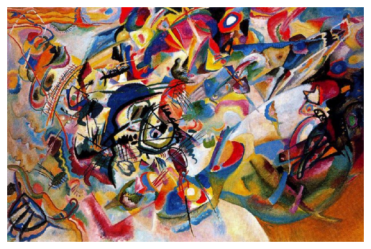

In [ ]:
from PIL import Image

base_image=Image.open('style.jpg')
plt.imshow(base_image)
plt.axis('off')
plt.show()

# Model

In [ ]:
from torchvision.models import inception_v3, Inception_V3_Weights

inception=inception_v3(weights=Inception_V3_Weights.IMAGENET1K_V1)

In [ ]:
vars(inception).keys()
inception._modules.keys()

odict_keys(['Conv2d_1a_3x3', 'Conv2d_2a_3x3', 'Conv2d_2b_3x3', 'maxpool1', 'Conv2d_3b_1x1', 'Conv2d_4a_3x3', 'maxpool2', 'Mixed_5b', 'Mixed_5c', 'Mixed_5d', 'Mixed_6a', 'Mixed_6b', 'Mixed_6c', 'Mixed_6d', 'Mixed_6e', 'AuxLogits', 'Mixed_7a', 'Mixed_7b', 'Mixed_7c', 'avgpool', 'dropout', 'fc'])

In [ ]:
class DeepDream(nn.Module):
    def __init__(self, layers):
        super().__init__()
        self.inception=inception_v3(weights=Inception_V3_Weights.IMAGENET1K_V1).eval()
        self.transform=transforms.Compose([
            transforms.Resize((224, 224)),
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
        ])
        self.layers=layers

    def forward(self,x):
        x=self.transform(x)
        outputs=[]
        for name, layer in self.inception.named_children():
            if name=='AuxLogits':
                continue
            x=layer(x)
            if name in self.layers:
                outputs.append(x)
                if(name==self.layers[-1]):
                    break

        return outputs

x=torch.rand(1,3,32,32)
tmp=DeepDream(['Mixed_5d', 'Mixed_6e'])
out=tmp(x)
print(len(out))
print(out[0].shape)
print(out[1].shape)

2
torch.Size([1, 288, 25, 25])
torch.Size([1, 768, 12, 12])


# Training

In [ ]:
from torchvision import transforms

image=nn.Parameter(transforms.ToTensor()(base_image)).to(device)
model=DeepDream(['Mixed_5d', 'Mixed_6e']).to(device)

  0%|          | 0/100 [00:00<?, ?it/s]

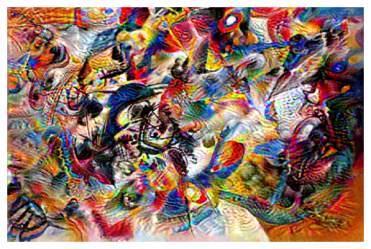

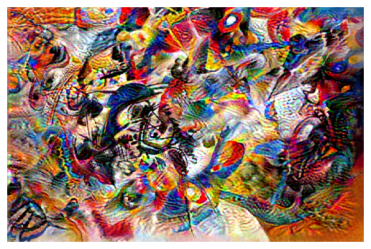

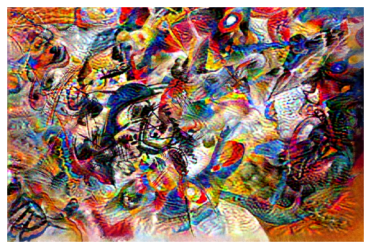

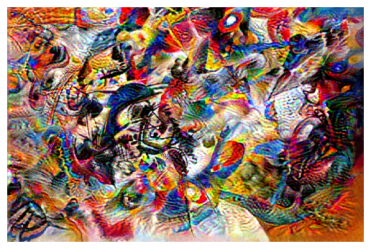

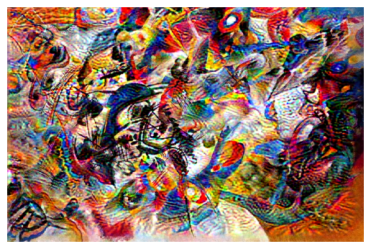

...

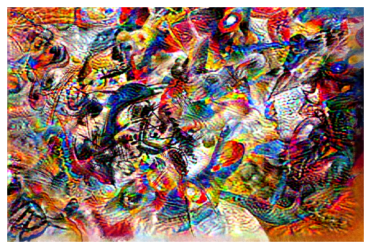

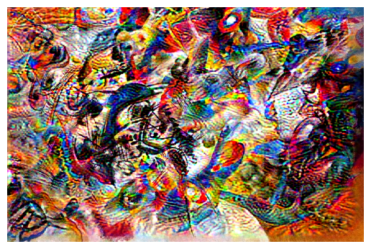

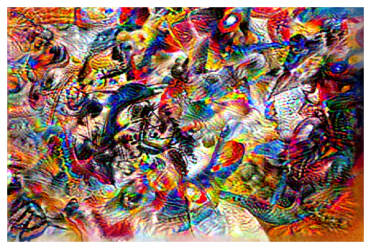

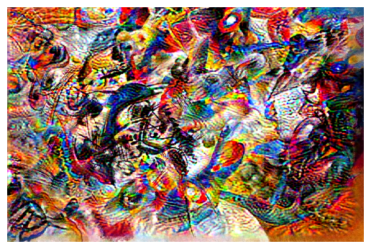

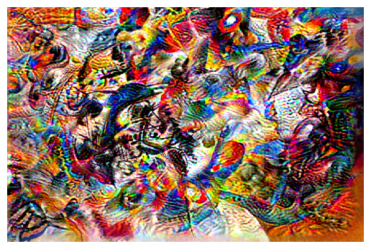

In [ ]:
import gc

gc.collect()
torch.cuda.empty_cache()
lr=1e-2
steps=100

p_bar=tqdm(range(steps))
for i in p_bar:
    outputs=model(image[None])
    outputs=[reduce(output, 'b c h w -> b 1', 'mean') for output in outputs]
    loss=sum(outputs)
    gradients = torch.autograd.grad(outputs=loss, inputs=image, create_graph=False)[0]
    gradients = gradients / (gradients.std() + 1e-8)
    gradients = gradients.detach()

    image = image + gradients * lr
    image = torch.clamp(image, -1, 1)

    p_bar.set_postfix(loss=loss.item())
    if p_bar.n%5==4:
        plt.imshow(image.detach().cpu().permute(1,2,0))
        plt.axis('off')
        plt.show()

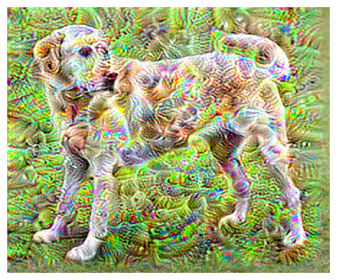

In [ ]:
plt.imshow(image.detach().cpu().permute(1,2,0))
plt.axis('off')
plt.show()